In [1]:
import ee

try:
    ee.Initialize(project='ee-gsingh')
except:
    ee.Authenticate()
    ee.Initialize()

import geemap
from geeml.utils import eeprint

import os
from tqdm.auto import tqdm
import geopandas as gpd
import pandas as pd

In [2]:
# for fired data polygons compute the area of gabam in each polygon,
# those that exceed threhold. carry out stratified sample.
# extract data compatable for training

fc = ee.FeatureCollection("projects/ee-geethensingh/assets/postdoc/proj_fired_south_africa_to2021182_events")
fireEvents = fc.map(lambda ft: ft.set('system:time_start', ee.Date(ft.get('ig_date')))
                    .set('system:time_end', ee.Date(ft.get('last_date')))).filterDate('2013-01-01', '2022-01-01')

sa = ee.FeatureCollection("USDOS/LSIB_SIMPLE/2017").filterBounds(fc.first().geometry())
gabam = ee.ImageCollection("projects/sat-io/open-datasets/GABAM")

# eeprint(sa)
# Filter fire events to period and area of interest


In [34]:
def computeAreas(fire):
    year = ee.Date(fire.get('ig_date')).get('year')
    gabamYear = gabam.filterBounds(fire.geometry()).filterDate(ee.Date.fromYMD(year,1,1), ee.Date.fromYMD(year,1,1).advance(1, 'year'))
    gabamArea = ee.Image.pixelArea().multiply(ee.Image(gabamYear.mosaic())).rename('gabamArea').reduceRegion(
        ee.Reducer.sum(), geometry = fire.geometry(), scale = 30).getNumber('gabamArea')
    
    return fire.set('gabamArea',gabamArea.divide(1e6))

eeprint(computeAreas(fireEvents.first()))


# Ranking burn areas to label

In [3]:
td = ee.Image("CSP/ERGo/1_0/Global/SRTM_topoDiversity").rename("topDiversity")
glo30 = ee.ImageCollection("projects/sat-io/open-datasets/GLO-30")
aspect = glo30.map(lambda img: ee.Terrain.aspect(img).rename('aspect')).mosaic()
cropland = ee.ImageCollection("users/potapovpeter/Global_cropland_2019").mosaic().rename("cropland")
water = ee.Image(ee.ImageCollection("JRC/GSW1_4/YearlyHistory").filterDate("2021-01-01", "2022-01-01").first()).gte(2).unmask(0).rename('water')
treeCov =  ee.Image(ee.ImageCollection("projects/sat-io/open-datasets/GFCC30TC").filter(ee.Filter.eq('system:index', 'GFCC30TC_2015_V4')).first()).rename('treeCov')
EFT = ee.ImageCollection("projects/ee-gsingh/assets/terrestrial/realm_T").map(lambda img: img.gte(1).unmask(0).rename([img.get('id_no')])).toBands()

meanBands = cropland.addBands([water, td, aspect, treeCov, EFT])

In [ ]:
eeprint(meanBands.bandNames())

In [4]:
fc = ee.FeatureCollection("projects/ee-geethensingh/assets/postdoc/proj_fired_south_africa_to2021182_events").map(
    lambda ft: ft.set('Ig_Date', ee.Date(ft.get('ig_date')).format())
).filter(ee.Filter.gte('ig_year', 2013))
# eeprint(fc.size())

In [5]:
# Functions to create batches for large featureCollection
def kfolds_random(table, k, percent=None, replacement=False, seed=0xbeef):
    if percent is None:
        percent = 1.0 / k
    
    folds = ee.List.sequence(0, k - 1).map(lambda n: get_fold(n, table, k, percent, replacement, seed))
    return folds

def get_fold(n, table, k, percent, replacement, seed):
    n = ee.Number(n)
    offset = ee.Algorithms.If(replacement, n, 0)
    repl_seed = ee.Number(seed).add(offset)
    
    t = table.randomColumn('random', repl_seed)
    slice_filter = ee.Filter.And(
        ee.Filter.gte('random', ee.Number(percent).multiply(n)),
        ee.Filter.lt('random', ee.Number(percent).multiply(n.add(1)))
    )
    return t.filter(slice_filter)

# Example usage:
# k = 92
# folds = kfolds_random(pas, k)
# eeprint(ee.FeatureCollection(folds.get(0)).limit(5))

In [6]:
k =200
folds = kfolds_random(fc, k)
# eeprint(ee.FeatureCollection(folds.get(0)).size())

In [7]:
def getMetadata(feature, meanLayers, properties):
    year = ee.Date(feature.get('ig_date')).get('year')
    gabamYear = gabam.filterBounds(feature.geometry()).filterDate(ee.Date.fromYMD(year,1,1), ee.Date.fromYMD(year,1,1).advance(1, 'year'))
    gabamArea = ee.Image(gabamYear.mosaic().unmask(0)).rename('gabamArea').reduceRegion(
        ee.Reducer.mean(), geometry = feature.geometry(), scale = 30).getNumber('gabamArea')
    meanResult = meanLayers.reduceRegion(reducer = ee.Reducer.mean(), geometry = feature.geometry().bounds(), scale = 30, maxPixels =1e9)
    return feature.set(meanResult).select(properties).set('gabamArea',gabamArea)

test = fc.map(lambda ft: getMetadata(ft.bounds(), meanLayers= meanBands, properties = meanBands.bandNames().cat(['id','ig_date', 'last_date', 'gabamArea'])))
eeprint(test.limit(2))

In [ ]:
GRNPFireRecords = ee.data.computeFeatures({
    'expression': test.limit(2),
    'fileFormat': 'GEOPANDAS_GEODATAFRAME'
})

# Need to set the CRS.
# Make sure it matches the CRS of FeatureCollection geometries.
GRNPFireRecords.crs = 'EPSG:4326'

GRNPFireRecords.head()

In [8]:
k = 200
folds = kfolds_random(fc, k)
csv_file_path = r"C:\Users\coach\myfiles\data\fired_metadatav2_21022024.csv"

for i in tqdm(range(0, k)):
    fts = ee.FeatureCollection(folds.get(i))
    data = fts.map(lambda ft: getMetadata(ft, meanLayers=meanBands, properties= meanBands.bandNames().cat(['id','ig_date', 'last_date', 'gabamArea'])))

    # Conversion to GeoDataFrame
    gdf = ee.data.computeFeatures({
        'expression': data,
        'fileFormat': 'GEOPANDAS_GEODATAFRAME'
    })
    gdf.crs = 'EPSG:4326'

    # Convert the geometry column to WKT
    gdf['geometry'] = gdf['geometry'].apply(lambda geom: geom.wkt)

    # Determine if it's the first iteration (i == 0)
    write_header = i == 0

    # Write the GeoDataFrame to CSV
    gdf.to_csv(csv_file_path, mode='a', header=write_header, index=False)

  0%|          | 0/200 [00:00<?, ?it/s]

C:\Users\coach\AppData\Local\Temp\ipykernel_28172\3879693854.py:17: UserWarning: Geometry column does not contain geometry.
  gdf['geometry'] = gdf['geometry'].apply(lambda geom: geom.wkt)
C:\Users\coach\AppData\Local\Temp\ipykernel_28172\3879693854.py:17: UserWarning: Geometry column does not contain geometry.
  gdf['geometry'] = gdf['geometry'].apply(lambda geom: geom.wkt)
C:\Users\coach\AppData\Local\Temp\ipykernel_28172\3879693854.py:17: UserWarning: Geometry column does not contain geometry.
  gdf['geometry'] = gdf['geometry'].apply(lambda geom: geom.wkt)
C:\Users\coach\AppData\Local\Temp\ipykernel_28172\3879693854.py:17: UserWarning: Geometry column does not contain geometry.
  gdf['geometry'] = gdf['geometry'].apply(lambda geom: geom.wkt)
C:\Users\coach\AppData\Local\Temp\ipykernel_28172\3879693854.py:17: UserWarning: Geometry column does not contain geometry.
  gdf['geometry'] = gdf['geometry'].apply(lambda geom: geom.wkt)
C:\Users\coach\AppData\Local\Temp\ipykernel_28172\38796

In [1]:
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt

In [4]:
csv_file_path = r"C:\Users\coach\myfiles\data\fired_metadatav2_21022024.csv"
df = pd.read_csv(csv_file_path)

# clip tree cover values greater than 100 to 100
df['treeCov'] = df['treeCov'].clip(upper=100)

# Check for columns with only zeros and drop them
zero_columns = df.columns[df.eq(0).all()]
df = df.drop(zero_columns, axis=1)

# Perform exploratory data analysis
eda_columns = ['aspect', 'cropland', 'topDiversity', 'treeCov', 'water', 'gabamArea']
eda_columns = [col for col in eda_columns if col in df.columns]

if eda_columns:
    print(df[eda_columns].describe())
    print(df[eda_columns].corr())
else:
    print("All specified columns have been dropped due to containing only zeros.")


              aspect       cropland   topDiversity        treeCov  \
count  128423.000000  128423.000000  128418.000000  128423.000000   
mean      176.648884       0.146049       0.334931       8.560204   
std        49.308684       0.293416       0.246661       8.976126   
min         0.000000       0.000000       0.002502       0.000000   
25%       145.041346       0.000000       0.119040       4.095588   
50%       175.975704       0.000000       0.275089       5.951176   
75%       208.362320       0.071567       0.518771       9.293536   
max       343.067350       1.000000       1.000000     100.000000   

               water      gabamArea  
count  128423.000000  128423.000000  
mean        0.006746       0.468995  
std         0.055238       0.332268  
min         0.000000       0.000000  
25%         0.000000       0.103330  
50%         0.000000       0.532720  
75%         0.000000       0.754012  
max         1.000000       1.000000  
                aspect  cropland  to

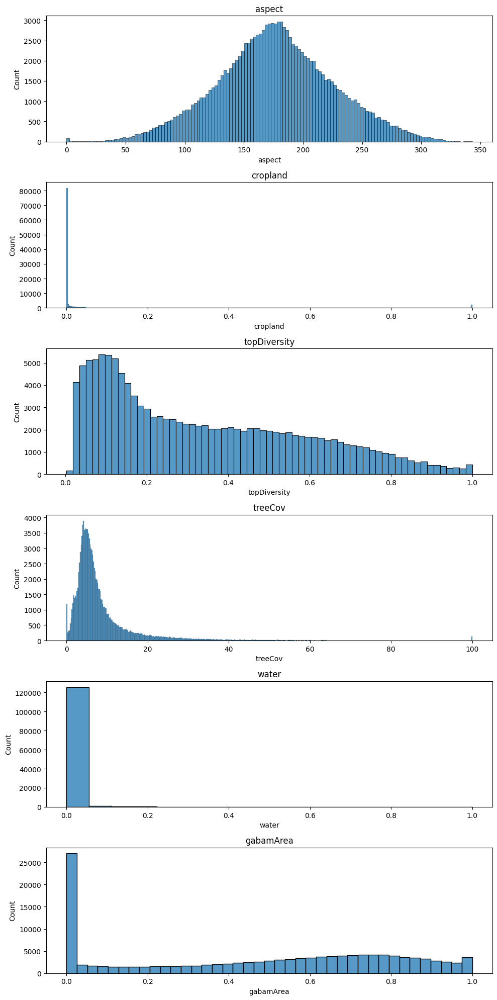

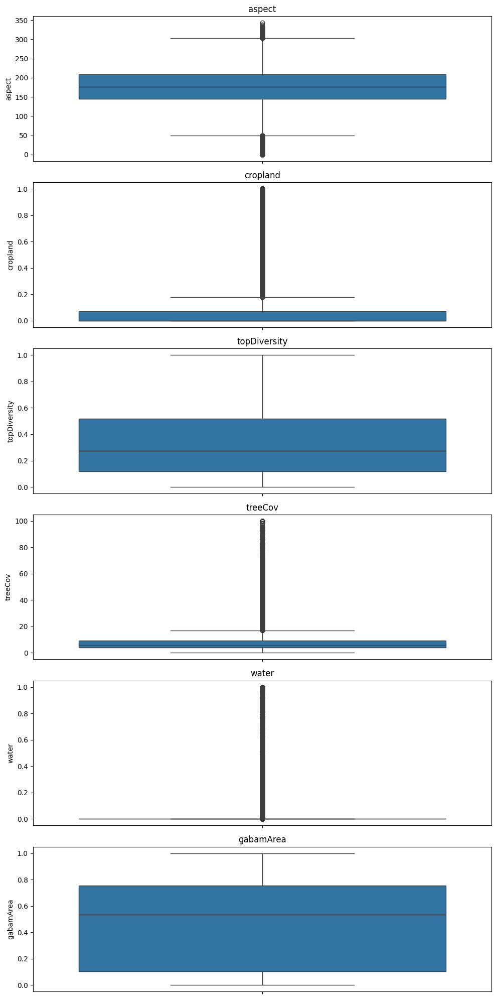

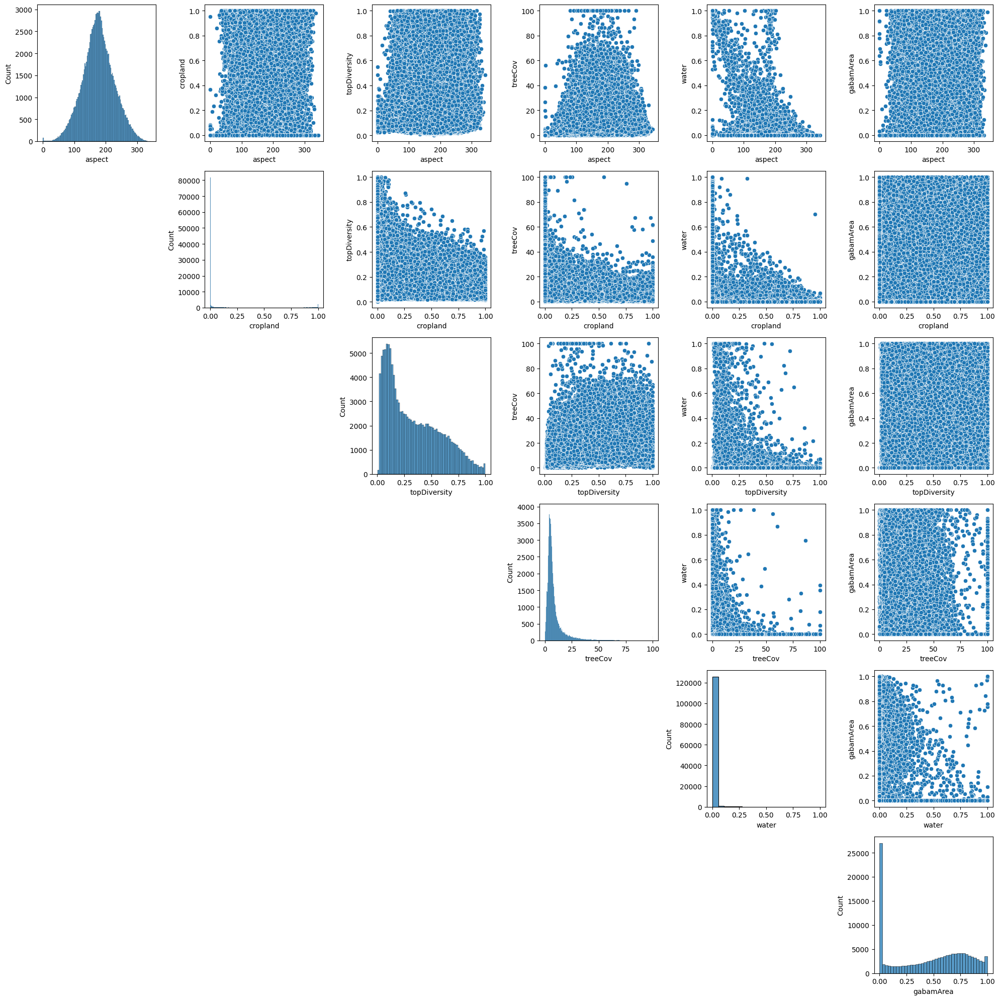

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create histograms for each column
eda_columns = ['aspect', 'cropland', 'topDiversity', 'treeCov', 'water', 'gabamArea']
eda_columns = [col for col in eda_columns if col in df.columns]

fig, axes = plt.subplots(nrows=len(eda_columns), figsize=(10, 20))
for ax, col in zip(axes, eda_columns):
    sns.histplot(df[col], ax=ax)
    ax.set_title(col)

plt.tight_layout()
plt.show()

# Create box plots for each column
fig, axes = plt.subplots(nrows=len(eda_columns), figsize=(10, 20))
for ax, col in zip(axes, eda_columns):
    sns.boxplot(df[col], ax=ax)
    ax.set_title(col)

plt.tight_layout()
plt.show()

# Create scatter plots to visualize relationships between columns
fig, axes = plt.subplots(nrows=len(eda_columns), ncols=len(eda_columns), figsize=(20, 20))
for i, col1 in enumerate(eda_columns):
    for j, col2 in enumerate(eda_columns):
        if i == j:
            sns.histplot(df[col1], ax=axes[i, j])
        elif i > j:
            axes[i, j].axis('off')
        else:
            sns.scatterplot(x=col1, y=col2, data=df, ax=axes[i, j])

plt.tight_layout()
plt.show()


# Ranking instances for finetuning 2

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

csv_file_path = r"C:\Users\coach\myfiles\data\fired_metadatav2_21022024.csv"
df = pd.read_csv(csv_file_path)

In [7]:
# Aspect

# Define a function to map aspect to cardinal points
def map_aspect_to_cardinal(aspect):
    if 337.5 <= aspect <= 360 or 0 <= aspect <= 22.5:
        return 'N'
    elif 22.5 < aspect <= 67.5:
        return 'NE'
    elif 67.5 < aspect <= 112.5:
        return 'E'
    elif 112.5 < aspect <= 157.5:
        return 'SE'
    elif 157.5 < aspect <= 202.5:
        return 'S'
    elif 202.5 < aspect <= 247.5:
        return 'SW'
    elif 247.5 < aspect <= 292.5:
        return 'W'
    elif 292.5 < aspect <= 337.5:
        return 'NW'

# Apply the function to the 'aspect' column
df['cardinal'] = df['aspect'].apply(map_aspect_to_cardinal)

# Create a dictionary to map cardinal directions to unique integers
cardinal_map = {'N': 1, 'NE': 2, 'E': 3, 'SE': 4, 'S': 5, 'SW': 6, 'W': 7, 'NW': 8}

# Map cardinal directions to unique integers
df['cardinal_id'] = df['cardinal'].map(cardinal_map)

# Normalize topDiversity and treeCov
df[['topDiversity', 'treeCov']] = df[['topDiversity', 'treeCov']].apply(lambda x: (x - x.min()) / (x.max() - x.min()))

# Compute the row-wise mean for the specified variables
eda_columns = ['cropland', 'topDiversity', 'treeCov', 'water', 'gabamArea']

df['priority_score'] = df[eda_columns].mean(axis=1)

Each combination has a unique code: True
Total number of unque combinations: 434


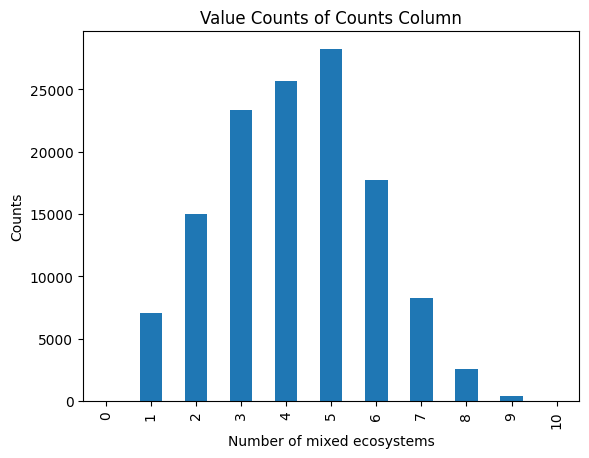

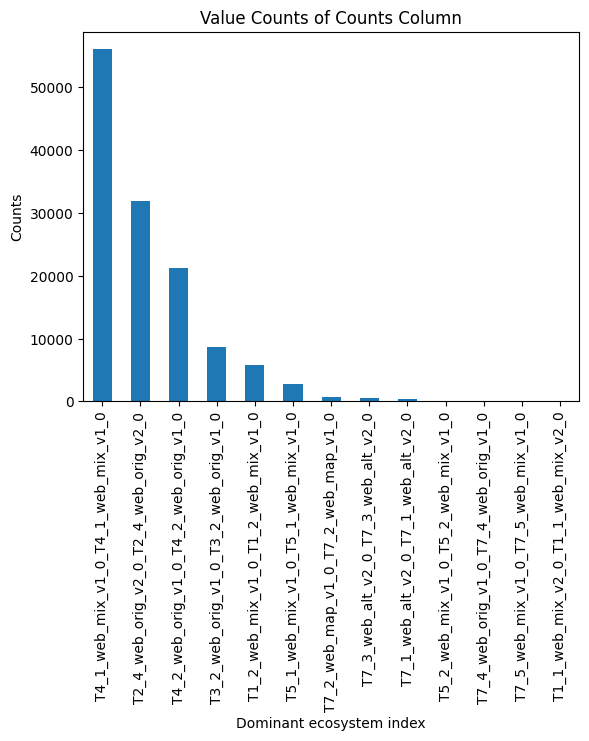

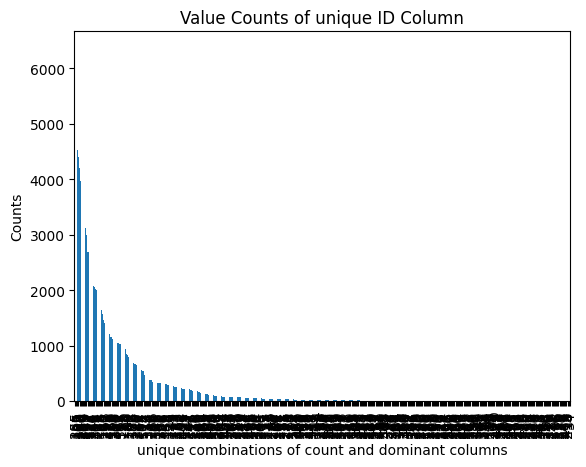

In [9]:
# Get all columns that start with 'T'
t_columns = [col for col in df.columns if col.startswith('T')]
df['counts'] = df[t_columns].ne(0).sum(axis=1)

# Create a new column 'dominant' based on the index of column in t_columns that has the highest value
df['dominant'] = df[t_columns].idxmax(axis=1)
df['dominant_idx'] = np.argmax(df[t_columns].values, axis=1)

# Create a new column 'unique_id' based on unique combinations of 'counts' and 'dominant_idx'
df['unique_id'] = df.groupby(['counts', 'dominant_idx', 'cardinal_id']).ngroup()
# Double check the unique id
print('Each combination has a unique code:', df.groupby(['counts', 'dominant_idx', 'cardinal_id'])['unique_id'].nunique().max() == 1)
print('Total number of unque combinations:', df['unique_id'].nunique())

# assuming df is a pandas DataFrame
df['counts'].value_counts().sort_index().plot(kind='bar')
plt.title('Value Counts of Counts Column')
plt.xlabel('Number of mixed ecosystems')
plt.ylabel('Counts')
plt.show()

df['dominant'].value_counts().plot(kind='bar')
plt.title('Value Counts of Counts Column')
plt.xlabel('Dominant ecosystem index')
plt.ylabel('Counts')
plt.show()

df['unique_id'].value_counts().plot(kind='bar')
plt.title('Value Counts of unique ID Column')
plt.xlabel('unique combinations of count and dominant columns')
plt.ylabel('Counts')
plt.show()

In [10]:
# Compute summary statistics
summary_stats = df['unique_id'].value_counts().describe()

# Print summary statistics
print(summary_stats)

count     434.000000
mean      295.905530
std       767.407807
min         1.000000
25%         3.000000
50%        21.000000
75%       159.000000
max      6349.000000
Name: count, dtype: float64


In [13]:
# Create a dictionary to store the indices for each unique id
unique_id_indices = {}

top_k = 50

# Iterate over each unique id
for unique_id in df['unique_id'].unique():
    # Get the rows for the current unique id
    unique_id_df = df[df['unique_id'] == unique_id]
    
    # If there are 5 or fewer rows, include all indices
    if len(unique_id_df) <= top_k:
        unique_id_indices[unique_id] = unique_id_df.index.tolist()
    # If there are more than 5 rows, select the 5 rows with the highest priority_score
    else:
        unique_id_indices[unique_id] = unique_id_df.nlargest(top_k, 'priority_score').index.tolist()

# Create a list of indices
indices = [index for indices in unique_id_indices.values() for index in indices]

# Print the list of indices
print(len(indices))

print(unique_id_indices)


10894
{np.int64(240): [103483, 48268, 83543, 43195, 25878, 80297, 120690, 27865, 15553, 109986, 66166, 82207, 1204, 47632, 28386, 109982, 98184, 10950, 4520, 27189, 76677, 68731, 91449, 56508, 68058, 70197, 21413, 85600, 111913, 93166, 89982, 36055, 52077, 79637, 3883, 17465, 10339, 91205, 46380, 16223, 88077, 117525, 42041, 51012, 119371, 124418, 29083, 23998, 123995, 97663], np.int64(46): [66268, 84926, 39351, 93854, 47252, 12633, 62403, 30489, 35067, 94500, 106153, 13434, 69433, 124020, 76753, 38758, 49834, 91929, 59850, 18506, 123989, 43468, 65794, 34904, 29336, 38095, 36181, 36539, 49157, 82469, 87813, 56916, 75299, 88138, 19618, 3912, 70984, 64540, 54781, 4609, 40702, 1, 95326, 40020, 42243, 118231, 67702, 7241, 68823, 22314], np.int64(166): [16396, 52174, 92020, 62486, 1265, 68819, 88157, 11772, 99843, 119019, 37209, 65591, 38795, 57870, 57844, 17577, 87505, 103582, 19668, 54087, 40663, 37807, 63107, 125156, 120860, 8518, 6513, 123215, 117649, 128386, 61803, 59128, 127775, 24927

In [14]:
# Get the first unique id
first_unique_id = df['unique_id'].unique()[0]
print(first_unique_id)

# Get the indices for the first unique id
first_unique_id_indices = unique_id_indices[first_unique_id]
print(first_unique_id_indices)

# Verify the indices by checking the corresponding rows in the DataFrame
display(df.loc[first_unique_id_indices])

# Check if the length of the indices is correct
print(len(first_unique_id_indices))

# Check if the indices correspond to the correct unique id
print(df.loc[first_unique_id_indices, 'unique_id'].unique())

# Check if the indices correspond to the top 5 priority scores (if applicable)
if len(df[df['unique_id'] == first_unique_id]) > 50:
    print(df.loc[first_unique_id_indices, 'priority_score'].tolist())
    print(df.loc[first_unique_id_indices, 'priority_score'].tolist() == df[df['unique_id'] == first_unique_id].nlargest(3, 'priority_score')['priority_score'].tolist())


240
[103483, 48268, 83543, 43195, 25878, 80297, 120690, 27865, 15553, 109986, 66166, 82207, 1204, 47632, 28386, 109982, 98184, 10950, 4520, 27189, 76677, 68731, 91449, 56508, 68058, 70197, 21413, 85600, 111913, 93166, 89982, 36055, 52077, 79637, 3883, 17465, 10339, 91205, 46380, 16223, 88077, 117525, 42041, 51012, 119371, 124418, 29083, 23998, 123995, 97663]


,geometry,T1_1_web_mix_v2_0_T1_1_web_mix_v2_0,T1_2_web_mix_v1_0_T1_2_web_mix_v1_0,T1_3_WM_nwx_v1_0_T1_3_WM_nwx_v1_0,T1_4_web_orig_v2_0_T1_4_web_orig_v2_0,T2_1_web_mix_v1_0_T2_1_web_mix_v1_0,T2_2_web_mix_v1_0_T2_2_web_mix_v1_0,T2_3_web_orig_v1_0_T2_3_web_orig_v1_0,T2_4_web_orig_v2_0_T2_4_web_orig_v2_0,T2_5_web_alt_v2_0_T2_5_web_alt_v2_0,...,topDiversity,treeCov,water,cardinal,cardinal_id,priority_score,counts,dominant,dominant_idx,unique_id
103483,POLYGON ((29.44012667617257 -29.48540889293514...,0,0.0,0,0,0,0,0,1.0,0,...,0.811679,0.369408,0.000000,S,5,0.422469,5,T2_4_web_orig_v2_0_T2_4_web_orig_v2_0,7,240
48268,POLYGON ((29.657699558265413 -29.4437430248832...,0,0.0,0,0,0,0,0,1.0,0,...,0.711130,0.360555,0.000000,S,5,0.414337,5,T2_4_web_orig_v2_0_T2_4_web_orig_v2_0,7,240
83543,POLYGON ((29.415677400573077 -29.2020731372176...,0,0.0,0,0,0,0,0,1.0,0,...,0.922373,0.144695,0.000000,S,5,0.412667,5,T2_4_web_orig_v2_0_T2_4_web_orig_v2_0,7,240
43195,POLYGON ((29.4041551258406 -29.460406695816143...,0,0.0,0,0,0,0,0,1.0,0,...,0.768875,0.246775,0.000000,S,5,0.402843,5,T2_4_web_orig_v2_0_T2_4_web_orig_v2_0,7,240
25878,POLYGON ((29.355136226462648 -29.4729055400085...,0,0.0,0,0,0,0,0,1.0,0,...,0.996805,0.043976,0.000000,S,5,0.401922,5,T2_4_web_orig_v2_0_T2_4_web_orig_v2_0,7,240
80297,POLYGON ((29.53936396833298 -29.46457597200212...,0,0.0,0,0,0,0,0,1.0,0,...,0.735818,0.380476,0.002886,S,5,0.399658,5,T2_4_web_orig_v2_0_T2_4_web_orig_v2_0,7,240
120690,POLYGON ((29.395085270357026 -29.6104063989589...,0,0.0,0,0,0,0,0,1.0,0,...,0.961531,0.045595,0.000000,S,5,0.399459,5,T2_4_web_orig_v2_0_T2_4_web_orig_v2_0,7,240
27865,POLYGON ((29.307664625098486 -29.6229097015799...,0,0.0,0,0,0,0,0,1.0,0,...,0.951463,0.040050,0.000000,S,5,0.398303,5,T2_4_web_orig_v2_0_T2_4_web_orig_v2_0,7,240
15553,POLYGON ((29.49343079228661 -29.30624215028413...,0,0.0,0,0,0,0,0,1.0,0,...,0.674595,0.312101,0.000000,S,5,0.397339,5,T2_4_web_orig_v2_0_T2_4_web_orig_v2_0,7,240
109986,POLYGON ((29.421634763800977 -29.1895742849224...,0,0.0,0,0,0,0,0,1.0,0,...,0.758178,0.226498,0.000000,S,5,0.396935,5,T2_4_web_orig_v2_0_T2_4_web_orig_v2_0,7,240


50
[240]
[0.422469313837505, 0.4143371632186551, 0.41266682072963634, 0.4028433614510657, 0.40192159962225543, 0.399657686207053, 0.3994586647323274, 0.39830258579472533, 0.3973392051725906, 0.3969352605014377, 0.39609246744038407, 0.3939558583224338, 0.3938562166183278, 0.393472386190839, 0.3920977189878393, 0.3911611001977783, 0.3903566006145006, 0.3899408350154131, 0.38939867013841983, 0.3882845047807181, 0.38823718423838866, 0.38816518403867367, 0.3864735378248289, 0.3862821627576987, 0.38613595750184493, 0.3857980348990944, 0.38525669183490574, 0.3851318290154116, 0.3826283072536817, 0.38256677862312527, 0.3823502202925539, 0.3821875995624409, 0.3816846781428987, 0.380473292553903, 0.3803926512337417, 0.3795574268957108, 0.3785822171948166, 0.37840464745490393, 0.37754915806937356, 0.37727403669433873, 0.3771513218411052, 0.37674773493483454, 0.3766366263125106, 0.3766061916916367, 0.37620477393099805, 0.37570081011897605, 0.37519061861660363, 0.3749151859121464, 0.374673688923781

In [16]:
labelFires = df.loc[indices]

# Step 2: Convert the WKT strings back to Shapely geometry objects
labelFires['geometry'] = gpd.GeoSeries.from_wkt(labelFires['geometry'])

# Step 3: Create a GeoDataFrame
gdf = gpd.GeoDataFrame(labelFires, geometry='geometry')
gdf.crs = 'EPSG:4326'

# Save as shapefile
gdf.to_file(r"C:\Users\coach\myfiles\data\firesToDownload_21022025.shp")
# Upload shp to GEE
gdf.explore()

C:\Users\coach\AppData\Local\Temp\ipykernel_25748\240636788.py:11: UserWarning: Column names longer than 10 characters will be truncated when saved to ESRI Shapefile.
  gdf.to_file(r"C:\Users\coach\myfiles\data\firesToDownload_21022025.shp")
c:\ProgramData\Anaconda3\envs\erthy\Lib\site-packages\pyogrio\raw.py:723: RuntimeWarning: Normalized/laundered field name: 'T1_1_web_mix_v2_0_T1_1_web_mix_v2_0' to 'T1_1_web_m'
  ogr_write(
c:\ProgramData\Anaconda3\envs\erthy\Lib\site-packages\pyogrio\raw.py:723: RuntimeWarning: Normalized/laundered field name: 'T1_2_web_mix_v1_0_T1_2_web_mix_v1_0' to 'T1_2_web_m'
  ogr_write(
c:\ProgramData\Anaconda3\envs\erthy\Lib\site-packages\pyogrio\raw.py:723: RuntimeWarning: Normalized/laundered field name: 'T1_3_WM_nwx_v1_0_T1_3_WM_nwx_v1_0' to 'T1_3_WM_nw'
  ogr_write(
c:\ProgramData\Anaconda3\envs\erthy\Lib\site-packages\pyogrio\raw.py:723: RuntimeWarning: Normalized/laundered field name: 'T1_4_web_orig_v2_0_T1_4_web_orig_v2_0' to 'T1_4_web_o'
  ogr_write

# Download site data for labelling

In [ ]:
import geopandas as gpd
import ee
import geemap
from geeml.utils import eeprint
from tqdm.auto import tqdm

try:
    ee.Initialize()
except:
    ee.Authenticate()
    ee.Initialize()

import os

In [ ]:
fc = ee.FeatureCollection("projects/ee-geethensingh/assets/postdoc/firesToLabelv2").map(
    lambda ft: ft.set('Ig_Date', ee.Date(ft.get('ig_date')).format())
)

fcList = fc.toList(1552)
eeprint(fc.size())

In [ ]:
event = fc.first()
eventDate = ee.Date(event.get('Ig_Date'))
print('event Date:', eventDate.format().getInfo())

event Date: 2020-09-07T00:00:00


In [ ]:
def preprocessOptical(image, sensor):
    """Select Bands and scale between 0 and 1
    """
    bandSelect = {'Sentinel-2': 'B.*',
                    'LANDSAT_8': 'SR_B.',
                    'LANDSAT_9': 'SR_B.'}
    # Step 2) radiometric correction
    radiometricMultiplySelect = {'Sentinel-2': 0.0001,
                    'LANDSAT_8': 0.0000275,
                    'LANDSAT_9': 0.0000275}
    radiometricAddSelect = {'Sentinel-2': 0,
                    'LANDSAT_8': -0.2,
                    'LANDSAT_9': -0.2}
    
    # Step 3) depending on image selected, select cloud band
    return image.select(bandSelect.get(sensor)).multiply(radiometricMultiplySelect.get(sensor)).add(radiometricAddSelect.get(sensor)).copyProperties(image)

# Sentinel-2 data exploration
def cloudMask1(imageCollection):
    #  Cloud Score+ image collection. Note Cloud Score+ is produced from Sentinel-2
        # Level 1C data and can be applied to either L1C or L2A collections.
        csPlus = ee.ImageCollection('GOOGLE/CLOUD_SCORE_PLUS/V1/S2_HARMONIZED')

        #  Use 'cs' or 'cs_cdf', depending on your use-case; see docs for guidance.
        QA_BAND = 'cs'

        # The threshold for masking; values between 0.50 and 0.65 generally work well.
        # Higher values will remove thin clouds, haze & cirrus shadows.
        CLEAR_THRESHOLD = 0.6

        # link Sentinel-2 image with corresponding Cloud Score+
        cloudMask = imageCollection.linkCollection(csPlus, [QA_BAND]).map(lambda img:
            img.updateMask(img.select(QA_BAND).gte(CLEAR_THRESHOLD)).select('B.*').divide(10000))

        # scale and mask out clouds
        return cloudMask

def cloudMask2(imageCollection):
        #  Cloud Score+ image collection. Note Cloud Score+ is produced from Sentinel-2
        # Level 1C data and can be applied to either L1C or L2A collections.
        csPlus = ee.ImageCollection('GOOGLE/CLOUD_SCORE_PLUS/V1/S2_HARMONIZED')

        #  Use 'cs' or 'cs_cdf', depending on your use-case; see docs for guidance.
        QA_BAND = 'cs'

        # The threshold for masking; values between 0.50 and 0.65 generally work well.
        # Higher values will remove thin clouds, haze & cirrus shadows.
        CLEAR_THRESHOLD = 0.6
        
        # radiometric correction and band selection
        # preProcessCollection = imageCollection.map(lambda image: preprocessOptical(image, 'Sentinel-2'))
        # link Sentinel-2 image with corresponding Cloud Score+
        # cloudMask = imageCollection.linkCollection(csPlus, [QA_BAND]).map(lambda img:
        #     img.addBands(img.normalizedDifference(['B8', 'B12']).multiply(10000).rename('nbr'))\
        #         .updateMask(img.select(QA_BAND).gte(CLEAR_THRESHOLD)).select(['B.*', 'nbr']).divide(10000)
        #     )
        cloudMask = imageCollection.linkCollection(csPlus, [QA_BAND]).map(lambda img:
            img.select(['B.*'])\
                .updateMask(img.select(QA_BAND).gte(CLEAR_THRESHOLD)).divide(10000)\
                    .addBands(img.normalizedDifference(['B8A', 'B12']).rename('nbr'))
            )
            
        # scale and mask out clouds
        return cloudMask

def qualityMosaicPercentile(collection, QAband, percentile):
    # Compute percentile image
    percentileImage = collection.select(QAband).reduce(ee.Reducer.percentile([percentile]))
    #  Compute distance of every pixel from the computed percentile in that location
    withDist = ee.ImageCollection(collection.map(lambda image: image.addBands([
        image.select(QAband).subtract(percentileImage).abs().multiply(-1).rename('quality')])))
    return withDist.qualityMosaic('quality')

In [ ]:
def getImage(sensor: str, pre: bool, event: ee.Feature, dateBuffer: int)->ee.Image:
    """
    Get the temporally closest pre-fire and post-fire optical or radar images after preprocessing both
    the optical images.

    Args:
        event (ee.Feature): A fire event delineating the boundary of burnt area
        dateBuffer (int): The temporal window to locate a relevant image. In units of weeks.

    Returns:
        A pre-fire and post-fire optical or radar image
    """
    # Filter images that intersect the geometry using the optimised filterBounds. Thereafter, use the
    # ee.filter.contains that is not as optimised as filterBounds
    images = supportedSensors.get(sensor).filterBounds(event.geometry())
    eventDate = ee.Date(event.get('Ig_Date'))
    if pre:
        startDate = eventDate.advance(dateBuffer*-1, 'week')
        endDate = eventDate
        outImage = cloudMask1(images.filterDate(startDate, endDate).sort('system:time_start', False)).reduce(ee.Reducer.firstNonNull()).regexpRename('.{6}$','')
        # .filter(ee.Filter.contains('.geo', event.geometry())).sort('system:time_start', False).first()

    else:
        # postfire
        startDate = eventDate
        endDate = eventDate.advance(dateBuffer, 'week')
        outImage = cloudMask2(images.filterDate(startDate, endDate))#.reduce(ee.Reducer.firstNonNull()).regexpRename('.{6}$','')#.qualityMosaic('nbr')
        # .filter(ee.Filter.contains('.geo', event.geometry())).sort('system:time_start', True).first()
    
    return outImage

    # Given a fire event get pre and post fire image from multi-sensors
def getOpticalRadarPairs(sensor:str, dnbr:bool, event: ee.Feature, dateBuffer: int = 4)-> ee.Image:
    """
    Get optical-radar pairs for a given fire event. First image after fire event and image before fire event

    Args:
        sensor(str): The name of the sensor. One of ['Sentinel-1', 'Sentinel-2', 'Landsat_8', 'Landsat_9']
        event(ee.Feature): A fire event
        dateBuffer(int): The temporal-search window. 
    
    Returns:
        An image with optical-radar pairs

    """
    # Post-fire image
    if sensor != 'any':
        postOpticalImage = getImage(sensor, False, event, dateBuffer= dateBuffer)
    else:
        s2post = getImage('Sentinel-2', False, event, dateBuffer= dateBuffer)
        l8post = getImage('LANDSAT_8', False, event, dateBuffer= dateBuffer)
        l9post = getImage('LANDSAT_9', False, event, dateBuffer= dateBuffer)
        # get the earliest optical image (between L8, L9 and S2) that was captured after the fire event
        postOpticalImage = ee.ImageCollection.fromImages([s2post, l8post, l9post]).sort('system:time_start', True).first()
    # pre-process post-fire image
    # postOpticalImage = ee.Image(preprocessOptical(postOpticalImage, sensor).copyProperties(postOpticalImage))

    # if sensor == 'Sentinel-1':
    #     # RADAR
    #     s1post = getImage('Sentinel-1', False, event, dateBuffer= dateBuffer)
    #     # preprocess pre-fire radar image
    #     parameters.update({'STOP_DATE': s1post.date().advance(1, 'day'), 'START_DATE': s1post.date(), 'ROI': event.geometry()})
    #     s1post = wp.s1_preproc(parameters).select('V.')
    
    # pre-fire
    if sensor != 'any':
        # If only one sensor is to be used
        preOpticalImage = getImage(sensor, True, event, dateBuffer= dateBuffer)
    else:
        # If any optical sensor is to be used
        s2pre = getImage('Sentinel-2', True, event, dateBuffer= dateBuffer)
        l8pre = getImage('LANDSAT_8', True, event, dateBuffer= dateBuffer)
        l9pre = getImage('LANDSAT_9', True, event, dateBuffer= dateBuffer)
        # get the earliest optical image (between L8, L9 and S2) that was captured after the fire event
        preOpticalImage = ee.ImageCollection.fromImages([s2pre, l8pre, l9pre]).sort('system:time_start', True).first()
    
    # elif multisensor:
    #     # if multisensor data is to be used, add radar to optical
    #     # RADAR
    #     s1pre = getImage('Sentinel-1', True, event, dateBuffer= dateBuffer)
    #     # preprocess pre-fire radar image
    #     parameters.update({'STOP_DATE': s1pre.date().advance(1, 'day'), 'START_DATE': s1pre.date(), 'ROI': event.geometry()})
    #     s1pre = wp.s1_preproc(parameters).select('V.')

    # pre-process pre-fire image
    # preOpticalImage = ee.Image(preprocessOptical(preOpticalImage, sensor).copyProperties(preOpticalImage))

    if dnbr:
        postOpticalImage = qualityMosaicPercentile(postOpticalImage.map(lambda img: img.addBands(
            preOpticalImage.normalizedDifference(['B8A', 'B12']).subtract(img.normalizedDifference(['B8A', 'B12'])).rename('dnbr'))), 'dnbr', 95) 
    
    return postOpticalImage
    # return preOpticalImage.regexpRename('$', '_pre'), s1pre, postOpticalImage.regexpRename('$', '_post'), s1post
    

In [ ]:
supportedSensors = {'Sentinel-1': ee.ImageCollection('COPERNICUS/S1_GRD'),
                    'Sentinel-2': ee.ImageCollection("COPERNICUS/S2_SR_HARMONIZED"),
                    'LANDSAT_8': ee.ImageCollection("LANDSAT/LC08/C02/T1_L2"),
                    'LANDSAT_9': ee.ImageCollection("LANDSAT/LC09/C02/T1_L2")}

In [ ]:
def prepareLabel(event: ee.Feature, patchSize: int, scale: int)-> ee.Image:
    """
    Converts a burn area polygon (ee.Feature) to a raster label. Burnt pixels are assigned a value of 1.
    Unburnt pixels are assigned a value of 0. the returned ee.Image dimensions should closely approximate
    the number of pixels divisible by the patchSize.

    Args:
        event(ee.Feature): The delineated burn area polygon to rasterize.
        patchSize (int): The desirable patch dimension when training the DNN model.
        scale (int): The desired output scale for the label.

    Returns:
        The rasterised label (ee.Image)
    """
    # Define the WKT string for EPSG:102005
    wkt = ('PROJCS["USA_Contiguous_Equidistant_Conic",'
        'GEOGCS["GCS_North_American_1983",'
        'DATUM["D_North_American_1983",'
        'SPHEROID["GRS_1980",6378137.0,298.257222101]],'
        'PRIMEM["Greenwich",0.0],'
        'UNIT["Degree",0.0174532925199433]],'
        'PROJECTION["Equidistant_Conic"],'
        'PARAMETER["False_Easting",0.0],'
        'PARAMETER["False_Northing",0.0],'
        'PARAMETER["longitude_of_center",-96.0],'
        'PARAMETER["Standard_Parallel_1",33.0],'
        'PARAMETER["Standard_Parallel_2",45.0],'
        'PARAMETER["latitude_of_center",39.0],'
        'UNIT["Meter",1.0]]')

    # Create the ee.Projection object
    projection = ee.Projection(wkt)
    
    # Create a covering grid using the equal-distance projection. each cell is 1 patch
    covering_grid = event.geometry().coveringGrid(projection, patchSize*scale).geometry().bounds(scale*0.9)
    
    # Return binary label, 1= burn pixels, 0 = unburnt pixels
    extent = ee.Image.constant(1).clip(covering_grid)
    burnt = ee.Image.constant(1).clip(event.geometry())
        
    label = extent.updateMask(burnt).unmask(0)
    return label.rename('label')

In [ ]:
from datetime import datetime
def downloadInstance(event, dateBuffer, patchSize, scale, id, rootdir):
    bands = ['B2', 'B3', 'B4', 'B5', 'B6', 'B7', 'B8A', 'B11', 'B12', 'nbr', 'dnbr']
    postOpt = getOpticalRadarPairs('Sentinel-2', True, event, dateBuffer).select(bands)
    label = prepareLabel(event, patchSize, scale).where(postOpt.select('dnbr').lt(0.1), 0).toInt()
    xfilename = Path(f"{rootdir}/X/image_{id}.tif")
    if not os.path.exists(xfilename.parent):
        os.makedirs(xfilename.parent)
    # BaseImage(postOpt).download(xfilename, crs='EPSG:4326', region= label.geometry(), scale= scale, overwrite=True, num_threads=20)
    yfilename = Path(f"{rootdir}/Y/label_{id}.tif")
    if not os.path.exists(yfilename.parent):
        os.makedirs(yfilename.parent)
    # BaseImage(label).download(yfilename, crs='EPSG:4326', region= label.geometry(), scale= scale, overwrite=True, num_threads=20)
    eventYear = datetime.strptime(event.get('ig_date').getInfo(), "%Y-%m-%d").year
    gabam = ee.ImageCollection("projects/sat-io/open-datasets/GABAM").filterDate(f"{eventYear}-01-01", f"{eventYear+1}-01-01")
    altlabel = ee.Image(gabam.mosaic())
    yfilename = Path(f"{rootdir}/altY/label_{id}.tif")
    if not os.path.exists(yfilename.parent):
        os.makedirs(yfilename.parent)
    BaseImage(altlabel).download(yfilename, crs='EPSG:4326', region= label.geometry(), scale= scale, overwrite=True, num_threads=20)
    

fcSize = fc.size().getInfo()
print(f"There are {fcSize} fire events for labelling")
fcList = fc.toList(fcSize)

rootdir = "C:/Users/coach/myfiles/postdoc/Fire/data/toLabel"

for id in tqdm(range(fcSize)):
    fire = ee.Feature(fcList.get(id))
    try:
        downloadInstance(fire, 15, 256, 30, id, rootdir)
    except Exception as e:
        print(f"Fire event {id} failed with error: {e}")


In [ ]:
# For training on US MTBS data
import os
import rasterio
from rasterio.windows import Window
from tqdm.auto import tqdm

def create_chips(input_folder, output_folder, chip_size=256):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    
    for filename in tqdm(os.listdir(input_folder)):
        if filename.endswith('.tif'):
            filepath = os.path.join(input_folder, filename)
            
            with rasterio.open(filepath) as src:
                width, height = src.width, src.height
                meta = src.meta.copy()
                
                for i in range(0, width, chip_size):
                    for j in range(0, height, chip_size):
                        # Ensure that only 256x256 chips are saved
                        if (i + chip_size <= width) and (j + chip_size <= height):
                            window = Window(i, j, chip_size, chip_size)
                            transform = src.window_transform(window)
                            
                            chip = src.read(window=window)
                            chip_meta = meta.copy()
                            chip_meta.update({
                                "height": chip.shape[1],
                                "width": chip.shape[2],
                                "transform": transform
                            })
                            
                            chip_filename = f"{os.path.splitext(filename)[0]}_{i}_{j}.tif"
                            chip_filepath = os.path.join(output_folder, chip_filename)
                            
                            with rasterio.open(chip_filepath, 'w', **chip_meta) as dst:
                                dst.write(chip)

# Usage
input_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\DNN\train\images'
output_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\DNN\train\X_chips'
create_chips(input_folder, output_folder, chip_size=256)

# Usage
input_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\DNN\test\images'
output_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\DNN\test\X_chips'
create_chips(input_folder, output_folder, chip_size=256)

input_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\DNN\train\masks'
output_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\DNN\train\Y_chips'
create_chips(input_folder, output_folder, chip_size=256)

# Usage
input_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\DNN\test\masks'
output_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\DNN\test\Y_chips'
create_chips(input_folder, output_folder, chip_size=256)


  0%|          | 0/765 [00:00<?, ?it/s]

  0%|          | 0/124 [00:00<?, ?it/s]

  0%|          | 0/765 [00:00<?, ?it/s]

  0%|          | 0/124 [00:00<?, ?it/s]

In [ ]:
import os
import rasterio
from rasterio.windows import Window
from tqdm.auto import tqdm

def create_chips(input_folder, output_folder, chip_size=256):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)
    
    for filename in tqdm(os.listdir(input_folder)):
        if filename.endswith('.tif'):
            filepath = os.path.join(input_folder, filename)
            
            with rasterio.open(filepath) as src:
                width, height = src.width, src.height
                meta = src.meta.copy()
                
                for i in range(0, width, chip_size):
                    for j in range(0, height, chip_size):
                        # Ensure that only 256x256 chips are saved
                        if (i + chip_size <= width) and (j + chip_size <= height):
                            window = Window(i, j, chip_size, chip_size)
                            transform = src.window_transform(window)
                            
                            chip = src.read(window=window)
                            chip_meta = meta.copy()
                            chip_meta.update({
                                "height": chip.shape[1],
                                "width": chip.shape[2],
                                "transform": transform
                            })
                            
                            chip_filename = f"{os.path.splitext(filename)[0]}_{i}_{j}.tif"
                            chip_filepath = os.path.join(output_folder, chip_filename)
                            
                            with rasterio.open(chip_filepath, 'w', **chip_meta) as dst:
                                dst.write(chip)

# Usage
input_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\toLabel\X'
output_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\toLabel\X_chips'

# create_chips(input_folder, output_folder, chip_size=256)

input_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\toLabel\Y'
output_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\toLabel\Y_chips'

# create_chips(input_folder, output_folder, chip_size=256)

input_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\toLabel\altY'
output_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\toLabel\altY_chips'

create_chips(input_folder, output_folder, chip_size=256)


  0%|          | 0/973 [00:00<?, ?it/s]

In [ ]:
import os
import rasterio

def check_chip_sizes(output_folder, expected_size=(256, 256)):
    for filename in tqdm(os.listdir(output_folder)):
        if filename.endswith('.tif'):
            filepath = os.path.join(output_folder, filename)
            
            with rasterio.open(filepath) as src:
                width, height = src.width, src.height
                
                if (width, height) != expected_size:
                    print(f"{filename} is {width}x{height} pixels")

output_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\toLabel\X_chips'
check_chip_sizes(output_folder)
output_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\toLabel\Y_chips'
check_chip_sizes(output_folder)
output_folder = r'C:\Users\coach\myfiles\postdoc\Fire\data\toLabel\altY_chips'
check_chip_sizes(output_folder)

  0%|          | 0/370 [00:00<?, ?it/s]

  0%|          | 0/364 [00:00<?, ?it/s]

  0%|          | 0/370 [00:00<?, ?it/s]